In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
from tabulate import tabulate

import plotly.express as px
import plotly.graph_objects as go

from sklearn.datasets import load_iris
from mlxtend.plotting import plot_decision_regions
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import LabelEncoder

<hr style="height: 3px; background-color: black;">

### Loading the Dataset

In [2]:
# Load the Iris dataset
iris = load_iris(as_frame=True)

# Convert data and target attributes to DataFrame
iris_df = pd.concat([iris.data, iris.target], axis=1)
iris_df.columns = iris.feature_names + ['target']

# Replace numerical target values with class names
iris_df['target'] = iris.target_names[iris_df['target']]

<hr style="height: 3px; background-color: black;">

### Redefine Classes Into: virginica | non-virginica

In [3]:
for i in range(0, len(iris_df["target"])):
    if iris_df["target"][i] == 'virginica':
        iris_df.loc[i, "target"] = 'virginica'
    else:
        iris_df.loc[i, "target"] = 'non-virginica'

<hr style="height: 3px; background-color: black;">

## Descriptive Statistics

### Virginica Group

In [4]:
# pd.reset_option('display.max_rows')
# pd.set_option('display.max_rows', None)


In [5]:
iris_df

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target
0,5.1,3.5,1.4,0.2,non-virginica
1,4.9,3.0,1.4,0.2,non-virginica
2,4.7,3.2,1.3,0.2,non-virginica
3,4.6,3.1,1.5,0.2,non-virginica
4,5.0,3.6,1.4,0.2,non-virginica
...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,virginica
146,6.3,2.5,5.0,1.9,virginica
147,6.5,3.0,5.2,2.0,virginica
148,6.2,3.4,5.4,2.3,virginica


In [6]:
virginica_group = iris_df[iris_df.target == 'virginica']
virginica_group.head()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target
100,6.3,3.3,6.0,2.5,virginica
101,5.8,2.7,5.1,1.9,virginica
102,7.1,3.0,5.9,2.1,virginica
103,6.3,2.9,5.6,1.8,virginica
104,6.5,3.0,5.8,2.2,virginica


In [7]:
virginica_group.describe()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm)
count,50.00000,50.000000,50.000000,50.00000
mean,6.58800,2.974000,5.552000,2.02600
std,0.63588,0.322497,0.551895,0.27465
min,4.90000,2.200000,4.500000,1.40000
25%,6.22500,2.800000,5.100000,1.80000
50%,6.50000,3.000000,5.550000,2.00000
75%,6.90000,3.175000,5.875000,2.30000
max,7.90000,3.800000,6.900000,2.50000


- We can see that in the dataset we have 50 iris flowers of virginica species.
- Various statistics are clearly observable based on their various features/characteristics.
- From a quick glance: min, max and mean statistics are more informative.

### Non-Virginica Group

In [8]:
non_virginica_group = iris_df[iris_df.target == 'non-virginica']
non_virginica_group.head()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target
0,5.1,3.5,1.4,0.2,non-virginica
1,4.9,3.0,1.4,0.2,non-virginica
2,4.7,3.2,1.3,0.2,non-virginica
3,4.6,3.1,1.5,0.2,non-virginica
4,5.0,3.6,1.4,0.2,non-virginica


In [9]:
non_virginica_group.describe()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm)
count,100.000000,100.000000,100.000000,100.000000
mean,5.471000,3.099000,2.861000,0.786000
std,0.641698,0.478739,1.449549,0.565153
min,4.300000,2.000000,1.000000,0.100000
25%,5.000000,2.800000,1.500000,0.200000
50%,5.400000,3.050000,2.450000,0.800000
75%,5.900000,3.400000,4.325000,1.300000
max,7.000000,4.400000,5.100000,1.800000


- Similarly we can observe there are a total of 100 non-viriginica iris flowers in our dataset.
- From a quick glance this table is helpful to find anything unsual or even find any min/max outliers.

<hr style="height: 3px; background-color: black;">

## Histogram <small> for Each Feature.</small>

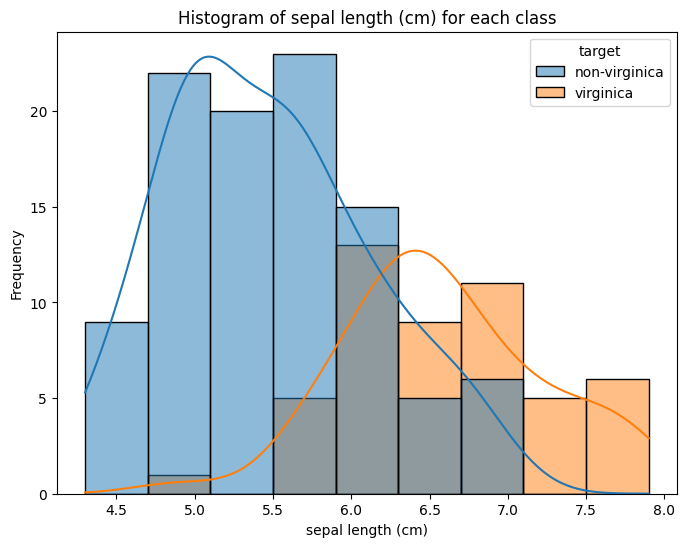

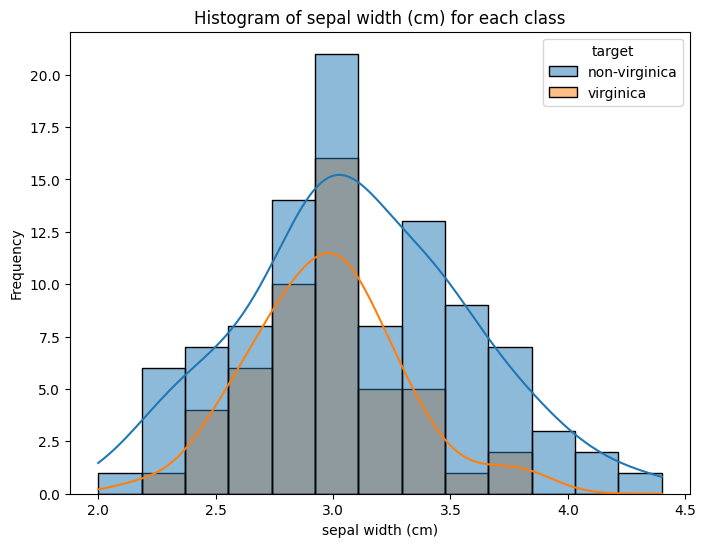

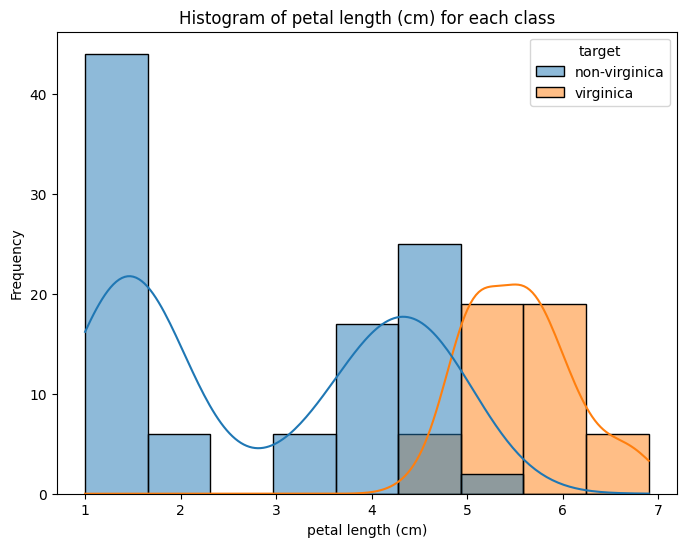

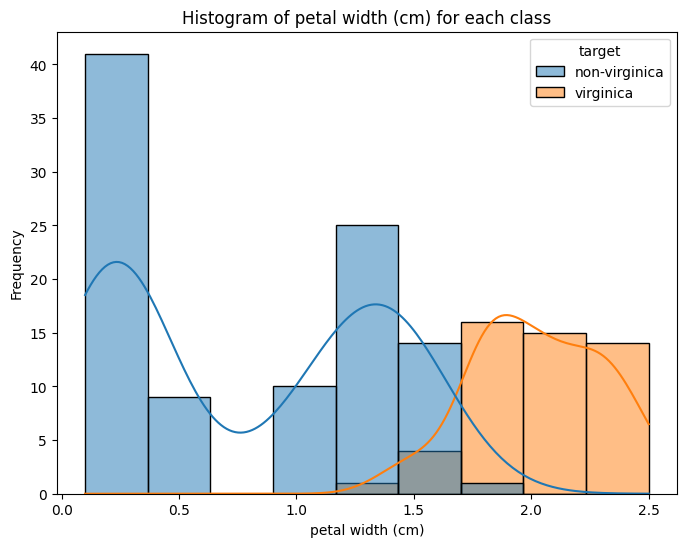

In [10]:
# Plot histograms for each feature, separated by class
for feature in iris_df.columns[:-1]:  # Exclude the target column
    plt.figure(figsize=(8, 6))
    sns.histplot(data=iris_df, x=feature, hue="target", hue_order=['non-virginica', 'virginica'], kde=True, legend=True)
    plt.title(f"Histogram of {feature} for each class")
    plt.xlabel(feature)
    plt.ylabel("Frequency")
    plt.show()


From the various histograms for each feature across the virginica and non-virginica group, we can analyze the relations and this helps get more insights from the dataset and clearly demonstrate the key differences between the two groups.

Non-Virginica group:
- Most have very low petal width and length among the iris flowers

Virginica group:
- They usually have higher petal width and length among the iris flowers

Sepal Length and width is observed to be evenly distributed across both iris groups.

<hr style="height: 3px; background-color: black;">

## Correlation Matrix

### Virginica, Non-Virginica Separately

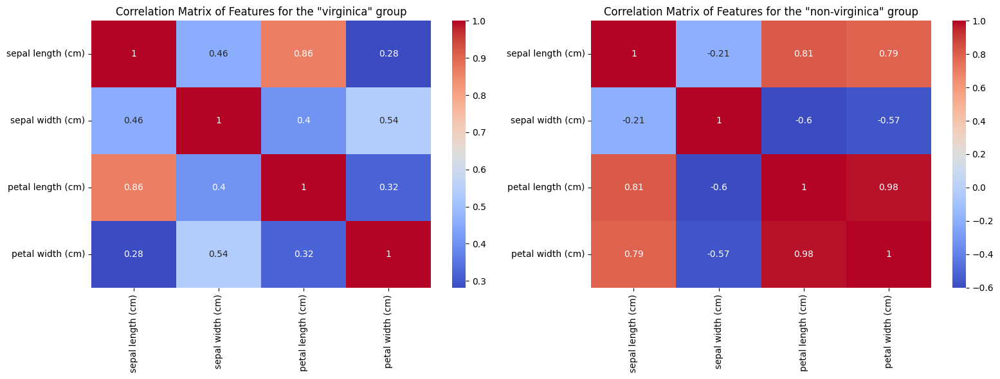

In [11]:
# Computing the correlation matrices
corr_matrix_virginica = virginica_group.iloc[:, :-1].corr()
corr_matrix_non_virginica = non_virginica_group.iloc[:, :-1].corr()


fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Virginica
sns.heatmap(corr_matrix_virginica, annot=True, cmap='coolwarm', ax=axes[0])
axes[0].set_title('Correlation Matrix of Features for the "virginica" group')

# Non-Virginica
sns.heatmap(corr_matrix_non_virginica, annot=True, cmap='coolwarm', ax=axes[1])
axes[1].set_title('Correlation Matrix of Features for the "non-virginica" group')

plt.tight_layout()
plt.show()


- We can see that there is a high correlation between the petal lenght and sepal length in the Virginica Group.

- There is a significantly high correlation between the petal lenght and petal width for the non-virginica group, which can be considered as a key factor to differenciate between Virginica and Non-Virginica groups.

#### Combined Dataset

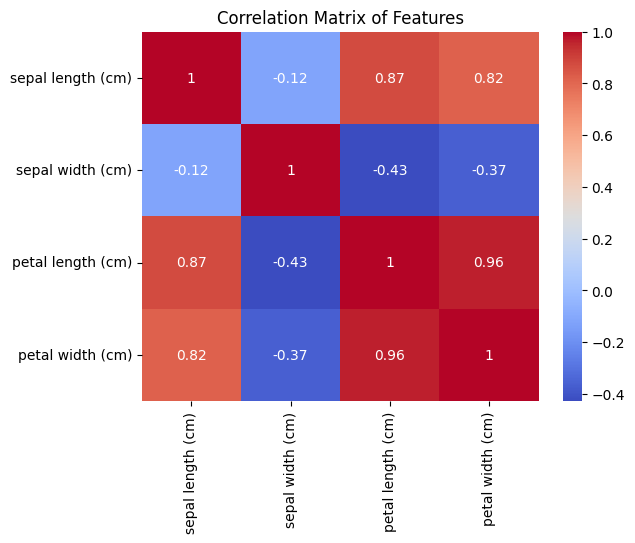

In [12]:
# Computing the correlation matrix
corr_matrix = iris_df.iloc[:, :-1].corr()

sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix of Features')
plt.show()


- This gives an overall view about the relationships between the attributes when conisdering the entire Iris Dataset without any classifications. 
- We can notice that the petal length - petal width, petal length - sepal lenght have relations.
- This information can be considered when trying to differentiate Iris flowers from other flowers in general.  

<hr style="height: 3px; background-color: black;">

## Kaggle References

### Violin Plots


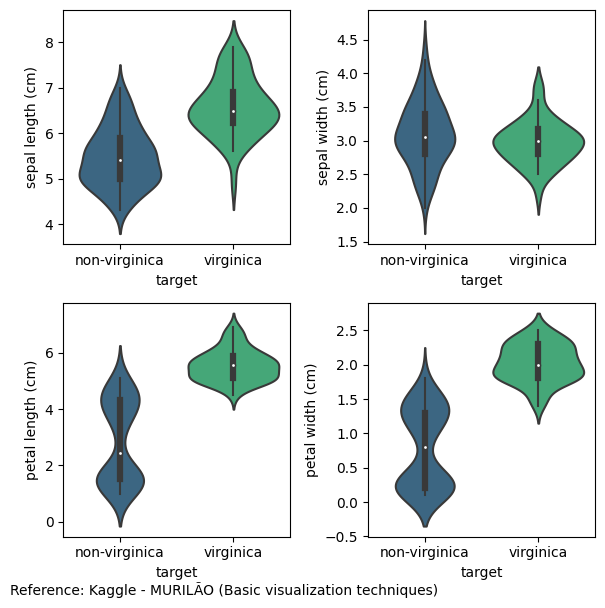

In [13]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(6, 6))

iris_features = iris_df.columns[:-1].to_list()

for i, ax in enumerate(axes.flatten()):
    sns.violinplot(data=iris_df, x="target", y=iris_df[iris_features[i]], palette="viridis", ax=ax)

plt.figtext(0, 0, "Reference: Kaggle - MURILÃO (Basic visualization techniques)")
plt.tight_layout()
plt.show()


Referenced: https://www.kaggle.com/code/upadorprofzs/basic-visualization-techniques

<hr style="height: 3px; background-color: black;">

### Box Plots

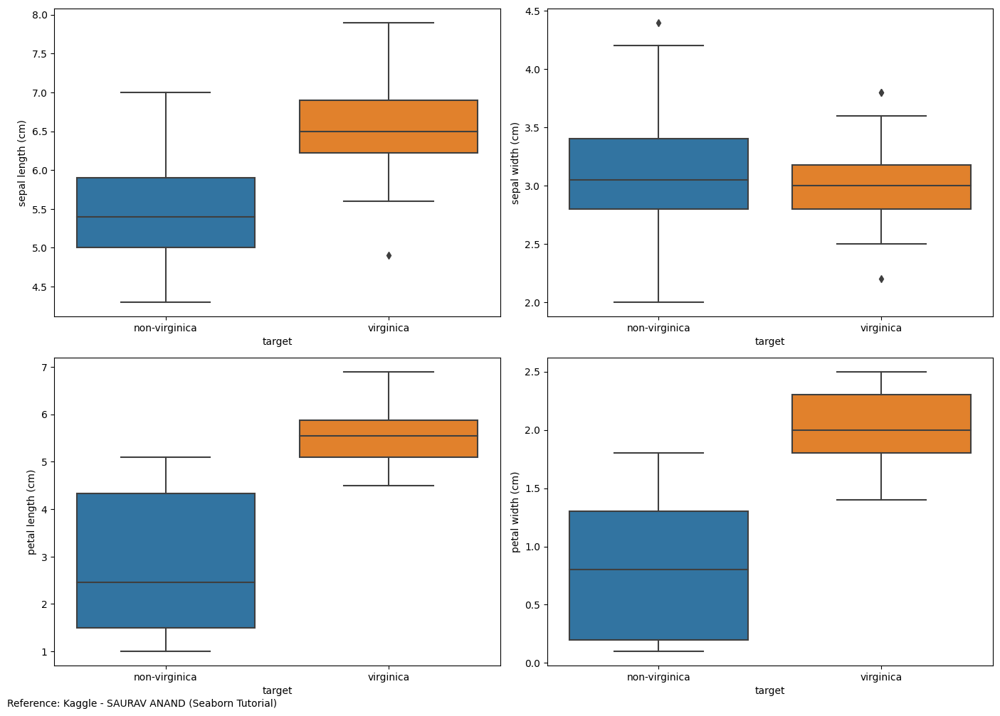

In [14]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(14, 10))

# Loop through and creating boxplots
for i, ax in enumerate(axes.flatten()):
    sns.boxplot(x='target', y=iris_df.columns[i], data=iris_df, ax=ax)


plt.figtext(0, 0, "Reference: Kaggle - SAURAV ANAND (Seaborn Tutorial)")
plt.tight_layout()
plt.show()

Referenced: https://www.kaggle.com/code/saurav9786/seaborn-tutorial

We can see that when the sepal lengths are considered: 
- Virginica Group has an outlier while considering sepal width.
- Virginica and non-Virginica group have single outlier each.

This can impact the model's prediction by a small percent, which can be checked while training and evaluation of models. 

<hr style="height: 3px; background-color: black;">

### Andrew Curves

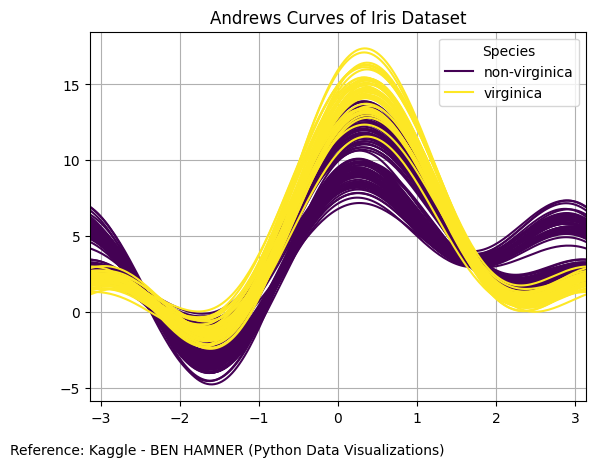

In [15]:
# Create Andrews curves
pd.plotting.andrews_curves(iris_df, 'target', colormap='viridis')

plt.figtext(0, 0, "Reference: Kaggle - BEN HAMNER (Python Data Visualizations)")
plt.title("Andrews Curves of Iris Dataset")
plt.legend(title='Species', loc='upper right')
plt.show()


Referenced: https://www.kaggle.com/code/benhamner/python-data-visualizations

These offer a concise visualization of multivariate data as they enables easy identification of underlying structures without extensive statistical analysis.

The following can be analyzed:
- Both species' curves demonstrate consistent wave-like patterns with similar peak levels and few similar features.
- There is a clear differences between both curves. Non-virginica curves generally exhibit lower values compared to virginica curves.

### Parallel Coordinates


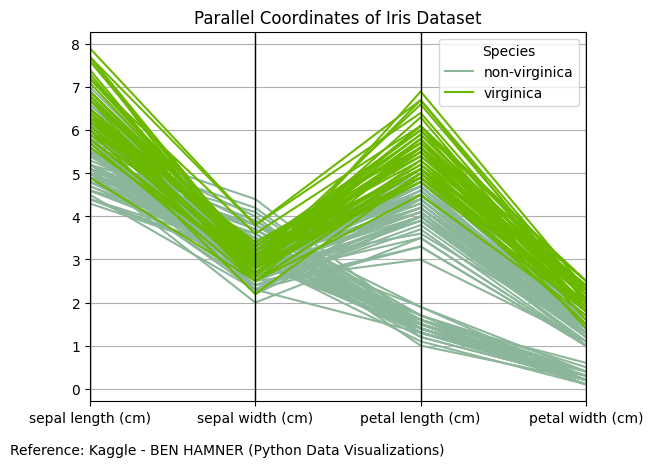

In [16]:
pd.plotting.parallel_coordinates(iris_df, "target")

plt.figtext(0, 0, "Reference: Kaggle - BEN HAMNER (Python Data Visualizations)")
plt.title("Parallel Coordinates of Iris Dataset")
plt.legend(title='Species', loc='upper right')
plt.show()

Referenced: https://www.kaggle.com/code/benhamner/python-data-visualizations


Parallel Coordinates provide clear relationships within multivariate data by allowing us to do a straightforward comparison of multiple variables across different species, identifying distinct patterns and trends.

We can analyze that:
- Non-virginica generally exhibits wider sepal widths but shorter petals compared to virginica.

- Virginica species tend to have longer and narrower sepals alongside longer petals.



---

## Splitting the Data into Train, Validation and Test

In [17]:
# Splitting the data into 120 records for train and 30 records for test initially
X_train, X_temp, y_train, y_temp = train_test_split(iris_df.iloc[:, :-1], iris_df['target'], test_size=0.2, random_state=42)

# Split test data into 15 records for validation, 15 records for test
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Display the shapes of the resulting sets
print("Train set shape:", X_train.shape, y_train.shape)
print("Validation set shape:", X_val.shape, y_val.shape)
print("Test set shape:", X_test.shape, y_test.shape)

Train set shape: (120, 4) (120,)
Validation set shape: (15, 4) (15,)
Test set shape: (15, 4) (15,)


In [18]:
print(X_train.isnull().sum())

sepal length (cm)    0
sepal width (cm)     0
petal length (cm)    0
petal width (cm)     0
dtype: int64


<hr style="height: 3px; background-color: black;">

## Logistic Regression
### Models with 1,2,3,4 Features

In [19]:
warnings.filterwarnings("ignore")

def train_and_evaluate(X_train, X_val, X_test, y_train, y_val, y_test, num_features):
    # Select the columns for training
    X_train_subset = X_train.iloc[:, :num_features]
    X_val_subset = X_val.iloc[:, :num_features]
    X_test_subset = X_test.iloc[:, :num_features]

    # Initialize and train logistic regression model
    model = LogisticRegression()
    model.fit(X_train_subset, y_train)

    # Make predictions on validation set
    y_pred_val = model.predict(X_val_subset)

    # Calculate accuracy on validation set
    accuracy_val = accuracy_score(y_val, y_pred_val)
    
    # Make predictions on test set
    y_pred_test = model.predict(X_test_subset)

    # Calculate accuracy on test set
    accuracy_test = accuracy_score(y_test, y_pred_test)

    del y_pred_val
    del y_pred_test
    del model

    return accuracy_val, accuracy_test

# Train and evaluate logistic regression models
feature_names = iris.feature_names
for num_features in range(1, 5):
    accuracy_val, accuracy_test = train_and_evaluate(X_train, X_val, X_test, y_train, y_val, y_test, num_features)
    print(f"Model with {num_features} feature:")
    print(f"Features: {', '.join(feature_names[:num_features])}")
    print(f"Validation accuracy: {accuracy_val:.2f}")
    print(f"Test accuracy: {accuracy_test:.2f}\n")

Model with 1 feature:
Features: sepal length (cm)
Validation accuracy: 0.93
Test accuracy: 0.93

Model with 2 feature:
Features: sepal length (cm), sepal width (cm)
Validation accuracy: 0.93
Test accuracy: 0.87

Model with 3 feature:
Features: sepal length (cm), sepal width (cm), petal length (cm)
Validation accuracy: 1.00
Test accuracy: 1.00

Model with 4 feature:
Features: sepal length (cm), sepal width (cm), petal length (cm), petal width (cm)
Validation accuracy: 1.00
Test accuracy: 1.00



<hr style="height: 3px; background-color: black;">

## Evaluate Model's Performance in Tables

In [20]:
def create_evaluation_table(model, X_val, y_val):
    # Make predictions and probabilities
    y_pred = model.predict(X_val)
    y_pred_proba = model.predict_proba(X_val)
    
    # Get the occurrence number from the original dataset
    occurrence_number = X_val.index + 1
    
    # Creating the evaluation table
    evaluation_table = pd.DataFrame({
        'Instance Number': occurrence_number,
        'Probability of Virginica': y_pred_proba[:, 1],
        'Prediction': y_pred,
        'Ground Truth': y_val
    })

    del y_pred
    del y_pred_proba

    return evaluation_table.set_index('Instance Number')

# Define a function to print the evaluation table for a given model
def print_evaluation_table(model_name, evaluation_table):
    print(f"Evaluation Table for Model: {model_name}")
    print(tabulate(evaluation_table, headers='keys', tablefmt='grid'))
    print()

# Iterate through each model and print its evaluation table
def individual_table(num_features):
    # Training the model
    model = LogisticRegression()
    model.fit(X_train.iloc[:, :num_features], y_train)
    
    # Creating the evaluation table
    evaluation_table = create_evaluation_table(model, X_val.iloc[:, :num_features], y_val)
    print_evaluation_table(f"Model with {num_features} feature(s)", evaluation_table)
    
    del model

    return evaluation_table


def calculate_accuracy(evaluation_table):
    # Count number of correct predictions
    correct_predictions = (evaluation_table['Prediction'] == evaluation_table['Ground Truth']).sum()
    
    # Total instances
    total_instances = len(evaluation_table)
    
    # Calculate accuracy
    accuracy = (correct_predictions / total_instances) * 100
    print(f"{accuracy:.2f}% is the prediction accuracy.")


In [21]:
predict_table = individual_table(1)
calculate_accuracy(predict_table)

Evaluation Table for Model: Model with 1 feature(s)
+-------------------+----------------------------+---------------+----------------+
|   Instance Number |   Probability of Virginica | Prediction    | Ground Truth   |
+===================+============================+===============+================+
|                27 |                  0.06451   | non-virginica | non-virginica  |
+-------------------+----------------------------+---------------+----------------+
|                19 |                  0.217912  | non-virginica | non-virginica  |
+-------------------+----------------------------+---------------+----------------+
|               119 |                  0.937717  | virginica     | virginica      |
+-------------------+----------------------------+---------------+----------------+
|               146 |                  0.671933  | virginica     | virginica      |
+-------------------+----------------------------+---------------+----------------+
|                79 |   

In [22]:
predict_table = individual_table(2)
calculate_accuracy(predict_table)

Evaluation Table for Model: Model with 2 feature(s)
+-------------------+----------------------------+---------------+----------------+
|   Instance Number |   Probability of Virginica | Prediction    | Ground Truth   |
+===================+============================+===============+================+
|                27 |                  0.050796  | non-virginica | non-virginica  |
+-------------------+----------------------------+---------------+----------------+
|                19 |                  0.145047  | non-virginica | non-virginica  |
+-------------------+----------------------------+---------------+----------------+
|               119 |                  0.949865  | virginica     | virginica      |
+-------------------+----------------------------+---------------+----------------+
|               146 |                  0.66928   | virginica     | virginica      |
+-------------------+----------------------------+---------------+----------------+
|                79 |   

In [23]:
predict_table = individual_table(3)
calculate_accuracy(predict_table)

Evaluation Table for Model: Model with 3 feature(s)
+-------------------+----------------------------+---------------+----------------+
|   Instance Number |   Probability of Virginica | Prediction    | Ground Truth   |
+===================+============================+===============+================+
|                27 |                1.57225e-05 | non-virginica | non-virginica  |
+-------------------+----------------------------+---------------+----------------+
|                19 |                1.3357e-05  | non-virginica | non-virginica  |
+-------------------+----------------------------+---------------+----------------+
|               119 |                0.998416    | virginica     | virginica      |
+-------------------+----------------------------+---------------+----------------+
|               146 |                0.697669    | virginica     | virginica      |
+-------------------+----------------------------+---------------+----------------+
|                79 |   

In [24]:
predict_table = individual_table(4)
calculate_accuracy(predict_table)

Evaluation Table for Model: Model with 4 feature(s)
+-------------------+----------------------------+---------------+----------------+
|   Instance Number |   Probability of Virginica | Prediction    | Ground Truth   |
+===================+============================+===============+================+
|                27 |                8.96424e-06 | non-virginica | non-virginica  |
+-------------------+----------------------------+---------------+----------------+
|                19 |                5.70191e-06 | non-virginica | non-virginica  |
+-------------------+----------------------------+---------------+----------------+
|               119 |                0.998534    | virginica     | virginica      |
+-------------------+----------------------------+---------------+----------------+
|               146 |                0.873922    | virginica     | virginica      |
+-------------------+----------------------------+---------------+----------------+
|                79 |   

### Summarizing the Table Data:

#### Using Accuracy as the Measure

The prediction values in the data among all the tables can be summarized easily by using the accuracy which is calculated by taking the number of correct predictions and dividing it by total number of predictions made (Valid Prediction / Total Predictions) and then converting this into a percentage to make it more readable.

Since both the model with three features and the model with four features achieved 100% accuracy on the validation set, I would likely choose either of these models for making predictions on new data. Using fewer features may offer computational advantages and could result in a simpler and more interpretable model. Therefore, I would simply choose the model with three features for its computational efficiency and simplicity.

<hr style="height: 3px; background-color: black;">

## Plotting the Decision Boundary

### Models with Feature 1 and 2

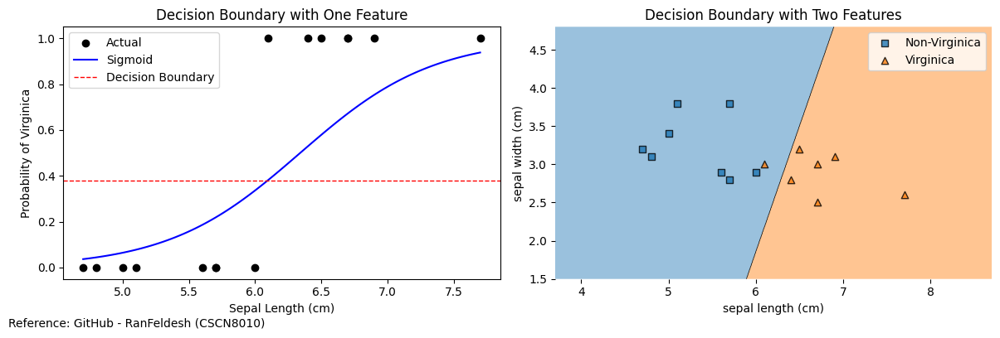

In [25]:
def train_plot_evaluate(X_train, X_val, y_train, y_val):
    fig, axes = plt.subplots(1, 2, figsize=(12, 4))

    # Train the logistic regression model on the training set with one feature
    model_1 = LogisticRegression()
    model_1.fit(X_train.iloc[:, :1], y_train)

    # Define the range of sepal length values for plotting
    X_val_feature = X_val[['sepal length (cm)']]
    y_val_target = y_val
    sepal_length_values = np.linspace(X_val_feature.min(), X_val_feature.max(), 100).reshape(-1, 1)

    # Predict probabilities for each value in the feature range
    probs = model_1.predict_proba(sepal_length_values)

    classes = model_1.classes_

    # Index of the positive class (assuming binary classification)
    positive_class_index = np.where(classes == 1)[0][0]

    # Threshold for classification (default is 0.5)
    decision_threshold = model_1.predict_proba(X_val_feature)[:, positive_class_index].mean()

    # Plot the feature against the target variable with decision boundary
    axes[0].scatter(X_val_feature, y_val_target, color='black', label='Actual')
    axes[0].plot(sepal_length_values, probs[:, 1], color='blue', label='Sigmoid')
    axes[0].axhline(y=decision_threshold, color='red', linestyle='dashed', linewidth=1, label='Decision Boundary')
    axes[0].set_xlabel('Sepal Length (cm)')
    axes[0].set_ylabel('Probability of Virginica')
    axes[0].set_title('Decision Boundary with One Feature')
    axes[0].legend()

    # Train the model with two features
    model_2 = LogisticRegression()
    model_2.fit(X_train.iloc[:, :2], y_train)

    # Plot decision boundary with two features
    plot_decision_regions(X_val.iloc[:, :2].values, y_val, clf=model_2, legend=2, ax=axes[1])
    axes[1].set_xlabel(X_train.columns[0])
    axes[1].set_ylabel(X_train.columns[1])
    axes[1].set_title("Decision Boundary with Two Features")
    handles, labels = axes[1].get_legend_handles_labels()
    axes[1].legend(handles, ["Non-Virginica", "Virginica"])

    plt.figtext(0, 0, "Reference: GitHub - RanFeldesh (CSCN8010)")
    plt.tight_layout()
    plt.show()

    # Delete models to free up memory
    del model_1, model_2

# Encode target labels
le = LabelEncoder()
y_train_encoded = le.fit_transform(y_train)
y_val_encoded = le.transform(y_val)

# Train, plot decision boundaries
train_plot_evaluate(X_train, X_val, y_train_encoded, y_val_encoded)

del y_train_encoded, y_val_encoded


### 3D Plot for Model with 3 Features

In [26]:
def plot_decision_boundary_3d(X, y, model):
    # Train the model
    model.fit(X, y)
    
    # Create a meshgrid for the features
    feature1_vals = X[:, 0]
    feature2_vals = X[:, 1]
    feature3_vals = X[:, 2]
    x_min, x_max = feature1_vals.min() - 1, feature1_vals.max() + 1
    y_min, y_max = feature2_vals.min() - 1, feature2_vals.max() + 1
    z_min, z_max = feature3_vals.min() - 1, feature3_vals.max() + 1
    xx, yy, zz = np.meshgrid(np.arange(x_min, x_max, 0.1),
                             np.arange(y_min, y_max, 0.1),
                             np.arange(z_min, z_max, 0.1))
    
    # Predict the labels for the meshgrid points
    Z = model.predict(np.c_[xx.ravel(), yy.ravel(), zz.ravel()])
    Z = Z.reshape(xx.shape)
    
    # Plot decision boundary
    fig = px.scatter_3d(x=feature1_vals, y=feature2_vals, z=feature3_vals, color=y)
    
    fig.add_trace(go.Surface(x=xx.squeeze(), y=yy.squeeze(), z=zz.squeeze(), 
                             surfacecolor=Z.squeeze(), colorscale='Viridis', opacity=0.5, 
                             showscale=False))
    
    # Plot decision boundary line
    coef = model.coef_.squeeze()
    intercept = model.intercept_
    x_plane = np.linspace(x_min, x_max, 10)
    y_plane = np.linspace(y_min, y_max, 10)
    xx_plane, yy_plane = np.meshgrid(x_plane, y_plane)
    z_plane = (-coef[0] * xx_plane - coef[1] * yy_plane - intercept) / coef[2]
    fig.add_trace(go.Surface(x=xx_plane, y=yy_plane, z=z_plane,
                             opacity=0.5, showscale=False))
    
    fig.update_layout(scene=dict(
            xaxis_title='sepal length (cm)',
            yaxis_title='sepal width (cm)',
            zaxis_title='petal length (cm)'),
            title='Decision Boundary for 3 Features')
    fig.add_annotation(x=0, y=0, text="Reference: GitHub - RanFeldesh (CSCN8010)", showarrow=False)

    fig.show()

    del model

# Encode target labels
le = LabelEncoder()
y_val_encoded = le.fit_transform(y_val)

# Convert DataFrame to numpy array
X_val_np = X_val.to_numpy()

model = LogisticRegression()
model.fit(X_val_np[:, :3], y_val_encoded)

plot_decision_boundary_3d(X_val_np[:, :3], y_val_encoded, model)

del model


Reference Used: https://github.com/CSCN8010/CSCN8010/blob/main/class_notebooks/logistic_regression/decision_boundry.ipynb

<hr style="height: 3px; background-color: black;">

## Failure Modes:

In [27]:
def analyze_failure_modes(model, X_val, y_val):
    # Make predictions on the validation set
    y_pred = model.predict(X_val)
    
    # Extract instances where the model makes incorrect predictions
    incorrect_predictions = X_val[y_pred != y_val].copy()
    incorrect_predictions['Predicted Class'] = y_pred[y_pred != y_val]
    incorrect_predictions['Ground Truth'] = y_val[y_pred != y_val]
    
    return incorrect_predictions

def analyze_failure_modes_for_models():
    # Store failure modes for each model
    failure_modes = {}
    
    for num_features in range(1, 5):
        # Train the model
        model = LogisticRegression()
        model.fit(X_train.iloc[:, :num_features], y_train)
        
        # Analyze failure modes
        failure_modes[f'Model with {num_features} feature(s)'] = analyze_failure_modes(model, X_val.iloc[:, :num_features], y_val)

    del model
    
    return failure_modes

# Get failure modes for each model
failure_modes = analyze_failure_modes_for_models()

for model_name, failure_mode_data in failure_modes.items():
    print(f"Failure Modes for {model_name}:")
    if not failure_mode_data.empty:
        print(failure_mode_data)
    else:
        print("No incorrect predictions.")
    print("\n")


Failure Modes for Model with 1 feature(s):
     sepal length (cm) Predicted Class Ground Truth
127                6.1   non-virginica    virginica


Failure Modes for Model with 2 feature(s):
     sepal length (cm)  sepal width (cm) Predicted Class Ground Truth
127                6.1               3.0   non-virginica    virginica


Failure Modes for Model with 3 feature(s):
No incorrect predictions.


Failure Modes for Model with 4 feature(s):
No incorrect predictions.




- There's one particular iris flower (instance 127) that both models (feature 1 and 2) struggle to classify correctly. It seems to have characteristics that make it hard for the models to decide its class.

- When we give the models more information about the flowers (using more features), they become better at telling the different types apart. This is shown by the fact that the models with more features don't make any mistakes.

- When we use all the available information about the flowers (4 features), the models perform perfectly—they don't make any mistakes. This means they're good at classifying all the flowers in the validation set.

<hr style="height: 3px; background-color: black;">

## Best Model

- Both models 3 and 4 correctly classify all instances in the validation set, but Model 3 is simpler with fewer features when compared to Model 4.

- As both models achieve the same level of accuracy, simpler models are preferred due to easier interpretation and lower risk of overfitting.
- Therefore, considering their identical performance on the validation set, we prefer Model 3 with 3 features due to its simplicity and computational efficiency.

### Evaluating the Best Model on Test Dataset

In [28]:
# Train the best model with 3 features
best_model = LogisticRegression()
best_model.fit(X_train.iloc[:, :3], y_train)
best_model_features = iris_df.columns[:3].to_list()

# Evaluate the best model on the test set using the same features
test_accuracy = best_model.score(X_test.iloc[:, :3], y_test)

test_accuracy_per = test_accuracy * 100

print(f"Best model with 3 features:\n{best_model_features}\nScores {test_accuracy_per}% Accuracy")

del best_model


Best model with 3 features:
['sepal length (cm)', 'sepal width (cm)', 'petal length (cm)']
Scores 100.0% Accuracy


The Logistic Regression Model with 3 features scores and accuracy of 100%.

Being able to predict all the instances of classifications correctly.

<hr style="height: 3px; background-color: black;">